# 데이터 다운로드 및 압축해제

In [ ]:
!gdown 10Hpa4YM0KX_Ig0W9w7DbTdq62nF2UThA

Downloading...
From: https://drive.google.com/uc?id=10Hpa4YM0KX_Ig0W9w7DbTdq62nF2UThA
To: /content/open.zip
100% 10.0M/10.0M [00:00<00:00, 284MB/s]


In [ ]:
!unzip open.zip

Archive:  open.zip
   creating: meta/
  inflating: meta/x_feature_info.csv  
  inflating: meta/y_feature_info.csv  
  inflating: meta/y_feature_spec_info.csv  
  inflating: sample_submission.csv   
  inflating: test.csv                
  inflating: train.csv               


# 데이터 살펴보기

## 데이터를 데이터프레임으로 불러오기

In [ ]:
import pandas as pd

train_df = pd.read_csv('train.csv')
train_df.head()

,ID,X_01,X_02,X_03,X_04,X_05,X_06,X_07,X_08,X_09,...,Y_05,Y_06,Y_07,Y_08,Y_09,Y_10,Y_11,Y_12,Y_13,Y_14
0,TRAIN_00001,70.544,103.320,67.47,1,101.892,74.983,29.45,62.38,245.71,...,29.632,16.083,4.276,-25.381,-25.529,-22.769,23.792,-25.470,-25.409,-25.304
1,TRAIN_00002,69.524,103.321,65.17,1,101.944,72.943,28.73,61.23,233.61,...,33.179,16.736,3.229,-26.619,-26.523,-22.574,24.691,-26.253,-26.497,-26.438
2,TRAIN_00003,72.583,103.320,64.07,1,103.153,72.943,28.81,105.77,272.20,...,31.801,17.080,2.839,-26.238,-26.216,-22.169,24.649,-26.285,-26.215,-26.370
3,TRAIN_00004,71.563,103.320,67.57,1,101.971,77.022,28.92,115.21,255.36,...,34.503,17.143,3.144,-25.426,-25.079,-21.765,24.913,-25.254,-25.021,-25.345
4,TRAIN_00005,69.524,103.320,63.57,1,101.981,70.904,29.68,103.38,241.46,...,32.602,17.569,3.138,-25.376,-25.242,-21.072,25.299,-25.072,-25.195,-24.974


In [146]:
x_feature_info = pd.read_csv('meta/x_feature_info.csv')
x_feature_info

,Feature,설명
0,X_01,PCB 체결 시 단계별 누름량(Step 1)
1,X_02,PCB 체결 시 단계별 누름량(Step 2)
2,X_03,방열 재료 1 무게
3,X_04,1차 검사 통과 여부
4,X_05,PCB 체결 시 단계별 누름량(Step 3)
5,X_06,PCB 체결 시 단계별 누름량(Step 4)
6,X_07,방열 재료 1 면적
7,X_08,방열 재료 2 면적
8,X_09,방열 재료 3 면적
9,X_10,방열 재료 2 무게


In [147]:
y_feature_info = pd.read_csv('meta/y_feature_info.csv')
y_feature_info

,Feature,설명
0,Y_01,안테나 Gain 평균 (각도1)
1,Y_02,안테나 1 Gain 편차
2,Y_03,안테나 2 Gain 편차
3,Y_04,평균 신호대 잡음비
4,Y_05,안테나 Gain 평균 (각도2)
5,Y_06,신호대 잡음비 (각도1)
6,Y_07,안테나 Gain 평균 (각도3)
7,Y_08,신호대 잡음비 (각도2)
8,Y_09,신호대 잡음비 (각도3)
9,Y_10,신호대 잡음비 (각도4)


In [ ]:
y_feature_spec_info = pd.read_csv('meta/y_feature_spec_info.csv')
y_feature_spec_info.head()

,Feature,최소,최대
0,Y_01,0.2,2.0
1,Y_02,0.2,2.1
2,Y_03,0.2,2.1
3,Y_04,7.0,19.0
4,Y_05,22.0,36.5


## x_feature의 상관관계 분석

In [ ]:
train_x = train_df[list(filter(lambda x: x[0] == 'X', train_df.columns))]
train_x.head()

,X_01,X_02,X_03,X_04,X_05,X_06,X_07,X_08,X_09,X_10,...,X_47,X_48,X_49,X_50,X_51,X_52,X_53,X_54,X_55,X_56
0,70.544,103.320,67.47,1,101.892,74.983,29.45,62.38,245.71,0.0,...,1,1,9706.03,137.043591,135.359219,147.837968,134.313475,125.605427,136.721425,125.028256
1,69.524,103.321,65.17,1,101.944,72.943,28.73,61.23,233.61,0.0,...,1,1,10423.43,133.736691,135.979817,149.924692,123.630583,127.893337,143.322659,124.877308
2,72.583,103.320,64.07,1,103.153,72.943,28.81,105.77,272.20,0.0,...,1,1,10948.53,132.805112,131.055355,146.814592,128.939070,127.012195,140.395688,122.238232
3,71.563,103.320,67.57,1,101.971,77.022,28.92,115.21,255.36,0.0,...,1,1,15007.03,134.138760,133.239422,139.720132,132.260824,130.723186,147.624829,134.875225
4,69.524,103.320,63.57,1,101.981,70.904,29.68,103.38,241.46,0.0,...,1,1,11051.03,142.728970,136.620022,134.853555,134.760252,125.647793,139.331105,123.272762


In [ ]:
train_x_corr = train_x.corr().round(1)
train_x_corr.head()

,X_01,X_02,X_03,X_04,X_05,X_06,X_07,X_08,X_09,X_10,...,X_47,X_48,X_49,X_50,X_51,X_52,X_53,X_54,X_55,X_56
X_01,1.0,-0.1,0.2,NaN,0.6,0.6,-0.0,0.0,-0.0,0.0,...,NaN,NaN,0.0,-0.0,0.0,0.0,0.0,0.0,-0.0,0.0
X_02,-0.1,1.0,-0.0,NaN,-0.0,-0.0,-0.0,-0.0,0.0,-0.0,...,NaN,NaN,-0.0,0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0
X_03,0.2,-0.0,1.0,NaN,-0.1,0.4,0.0,0.0,-0.1,-0.0,...,NaN,NaN,-0.0,-0.0,0.0,-0.1,0.1,-0.0,-0.1,-0.0
X_04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
X_05,0.6,-0.0,-0.1,NaN,1.0,0.1,-0.0,-0.0,-0.0,-0.0,...,NaN,NaN,-0.0,-0.0,-0.0,0.0,0.0,0.0,-0.0,-0.0


* NaN 값이 왜 나오지?

In [ ]:
train_x_corr.columns[train_x_corr.isna().all()].tolist()

['X_04', 'X_23', 'X_47', 'X_48']

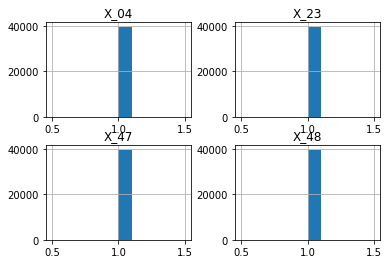

In [ ]:
for colname in [train_x_corr.columns[train_x_corr.isna().all()]]:
  train_x[colname].hist()

In [ ]:
list(set(train_x['X_04']))

[1]

In [ ]:
for colname in [train_x_corr.columns[train_x_corr.isna().all()]]:
  print('Column: {} Values:'.format(colname))

Column: Index(['X_04', 'X_23', 'X_47', 'X_48'], dtype='object') Values:


* 값을 1만 가지는 컬럼이 4개 있음. 일단 제외하기로 함.

In [ ]:
remove_columns = train_x_corr.columns[train_x_corr.isna().all()]
remove_columns

Index(['X_04', 'X_23', 'X_47', 'X_48'], dtype='object')

In [ ]:
train_x = train_x.drop(remove_columns, axis=1)
train_x.head()

,X_01,X_02,X_03,X_05,X_06,X_07,X_08,X_09,X_10,X_11,...,X_45,X_46,X_49,X_50,X_51,X_52,X_53,X_54,X_55,X_56
0,70.544,103.320,67.47,101.892,74.983,29.45,62.38,245.71,0.0,0.0,...,0.29,1463,9706.03,137.043591,135.359219,147.837968,134.313475,125.605427,136.721425,125.028256
1,69.524,103.321,65.17,101.944,72.943,28.73,61.23,233.61,0.0,0.0,...,0.13,1463,10423.43,133.736691,135.979817,149.924692,123.630583,127.893337,143.322659,124.877308
2,72.583,103.320,64.07,103.153,72.943,28.81,105.77,272.20,0.0,0.0,...,0.14,1468,10948.53,132.805112,131.055355,146.814592,128.939070,127.012195,140.395688,122.238232
3,71.563,103.320,67.57,101.971,77.022,28.92,115.21,255.36,0.0,0.0,...,0.22,1469,15007.03,134.138760,133.239422,139.720132,132.260824,130.723186,147.624829,134.875225
4,69.524,103.320,63.57,101.981,70.904,29.68,103.38,241.46,0.0,0.0,...,0.22,1469,11051.03,142.728970,136.620022,134.853555,134.760252,125.647793,139.331105,123.272762


* 다시 상관관계 분석

In [ ]:
train_x_corr = train_x.corr().round(1)
train_x_corr.head()

,X_01,X_02,X_03,X_05,X_06,X_07,X_08,X_09,X_10,X_11,...,X_45,X_46,X_49,X_50,X_51,X_52,X_53,X_54,X_55,X_56
X_01,1.0,-0.1,0.2,0.6,0.6,-0.0,0.0,-0.0,0.0,0.0,...,-0.1,0.0,0.0,-0.0,0.0,0.0,0.0,0.0,-0.0,0.0
X_02,-0.1,1.0,-0.0,-0.0,-0.0,-0.0,-0.0,0.0,-0.0,-0.0,...,0.0,-0.0,-0.0,0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0
X_03,0.2,-0.0,1.0,-0.1,0.4,0.0,0.0,-0.1,-0.0,-0.0,...,-0.0,0.0,-0.0,-0.0,0.0,-0.1,0.1,-0.0,-0.1,-0.0
X_05,0.6,-0.0,-0.1,1.0,0.1,-0.0,-0.0,-0.0,-0.0,-0.0,...,-0.1,0.0,-0.0,-0.0,-0.0,0.0,0.0,0.0,-0.0,-0.0
X_06,0.6,-0.0,0.4,0.1,1.0,0.1,0.0,-0.0,0.0,0.0,...,-0.1,-0.0,0.0,-0.0,0.0,-0.0,0.0,0.0,-0.1,0.0


* 시각화

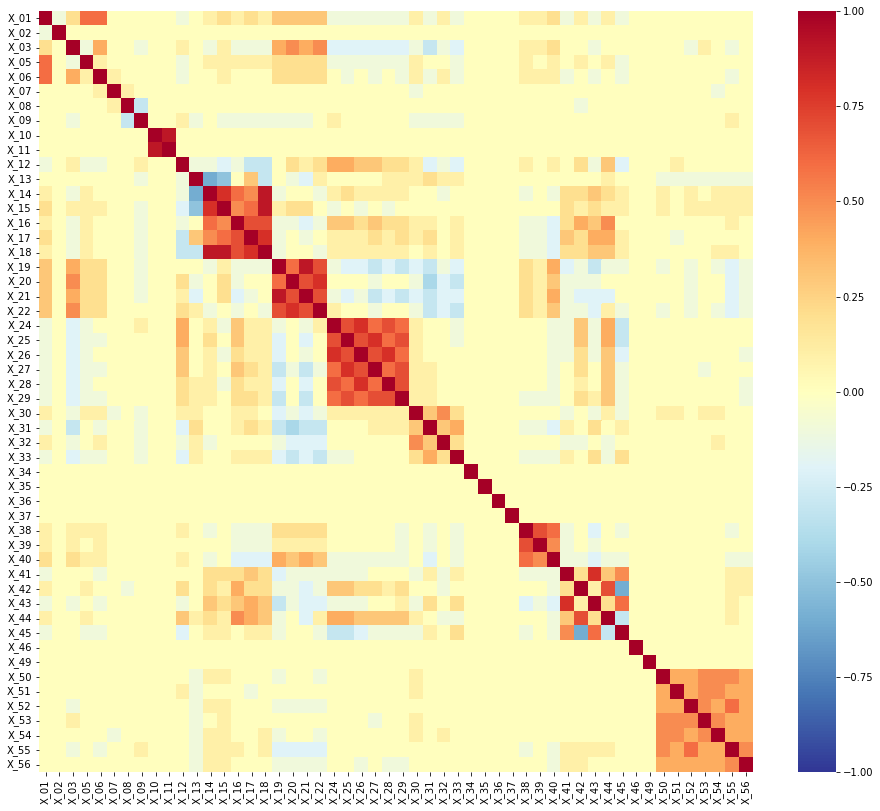

In [ ]:
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize = (16,14))

sns.heatmap(train_x_corr, 
            cmap = 'RdYlBu_r', 
            annot = False,
            vmin = -1,vmax = 1)   # 실제 값을 표시한다

* 0.9 이상인 리스트만 추려내보자

In [ ]:
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

def get_top_abs_correlations(df, n=5):
    au_corr = df.corr().abs().unstack()
    labels_to_drop = get_redundant_pairs(df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=False)
    return au_corr[0:n]

print("Top Absolute Correlations")
print(get_top_abs_correlations(train_x, 10))

Top Absolute Correlations
X_10  X_11    0.908978
X_14  X_18    0.860102
X_15  X_18    0.858704
X_19  X_21    0.855176
X_14  X_15    0.846266
X_20  X_22    0.831176
X_24  X_26    0.816194
X_41  X_43    0.798763
X_25  X_27    0.775328
X_17  X_18    0.758397
dtype: float64


* X_10과 X_11은 뭘까?

In [ ]:
x_feature_info.head(11).tail(2)

,Feature,설명
9,X_10,방열 재료 2 무게
10,X_11,방열 재료 3 무게


* 일단 다 넣고 돌려볼까?

In [ ]:
train_df = pd.read_csv('train.csv')

In [ ]:
from sklearn.model_selection import train_test_split
import numpy as np

X = train_df.filter(regex='X').drop(remove_columns, axis=1)
y = train_df.filter(regex='Y')

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=13)

np.unique(y_train, return_counts=True)

(array([-31.119, -30.788, -30.619, ...,  37.225,  37.25 ,  98.794]),
 array([1, 1, 1, ..., 1, 1, 1]))

In [ ]:
X_train.head()

,X_01,X_02,X_03,X_05,X_06,X_07,X_08,X_09,X_10,X_11,...,X_45,X_46,X_49,X_50,X_51,X_52,X_53,X_54,X_55,X_56
33302,66.465,103.320,66.67,101.903,69.884,29.75,116.14,209.02,0.0,0.0,...,0.09,1469,15545.23,133.437375,137.026272,134.416910,126.915655,128.299167,146.218930,135.038563
10799,70.544,103.320,74.47,101.921,72.943,31.73,1403.67,347.86,0.0,0.0,...,0.18,1469,10999.13,133.236462,130.882076,139.156786,121.354101,124.198948,137.372242,125.827923
33663,68.504,103.320,67.67,102.057,71.923,28.06,112.97,180.20,0.0,0.0,...,0.16,1469,13424.93,140.599911,136.685421,143.018228,136.371710,131.630276,141.985188,137.460232
1793,68.504,103.321,66.37,103.150,68.864,27.90,214.24,235.90,0.0,0.0,...,0.07,1469,16041.53,122.492413,124.094006,126.433427,119.969839,122.993084,134.765339,121.760975
19443,73.603,103.320,66.57,103.158,73.963,27.55,81.69,280.18,0.0,0.0,...,0.13,1469,13802.53,128.151494,130.248966,143.633691,129.932318,132.411457,138.888470,133.614292


In [ ]:
y_train.head()

,Y_01,Y_02,Y_03,Y_04,Y_05,Y_06,Y_07,Y_08,Y_09,Y_10,Y_11,Y_12,Y_13,Y_14
33302,0.898,0.727,0.658,13.836,32.654,16.452,3.499,-26.786,-26.719,-22.523,24.067,-26.741,-26.626,-26.718
10799,1.038,0.501,0.681,13.348,31.251,16.808,3.357,-26.021,-26.130,-22.027,24.319,-26.212,-26.092,-26.122
33663,1.513,1.408,1.247,14.448,33.744,16.381,3.202,-26.827,-26.777,-22.861,24.159,-26.796,-26.757,-26.887
1793,0.779,0.373,0.383,12.464,32.600,16.380,3.033,-25.704,-25.687,-22.647,24.287,-25.838,-25.694,-25.939
19443,1.858,1.212,1.399,12.183,32.697,16.833,3.416,-25.744,-25.539,-21.643,24.769,-25.505,-25.629,-25.566


In [136]:
# from sklearn.linear_model import LogisticRegression
# from sklearn.tree import DecisionTreeClassifier
from sklearn.multioutput import MultiOutputRegressor
from sklearn.ensemble import GradientBoostingRegressor
# from xgboost import XGBRegressor
from sklearn.ensemble import RandomForestRegressor
# from lightgbm import LGBMClassifier

# lr_clf = LogisticRegression(random_state=13, solver='liblinear')
# dt_clf = DecisionTreeClassifier(random_state=13, max_depth=4)
gb_reg = MultiOutputRegressor(GradientBoostingRegressor())
# xgb_reg = XGBRegressor()
rf_reg = RandomForestRegressor(random_state=13, n_jobs=-1, n_estimators=100)
# lgbm_clf = LGBMClassifier(n_estimators=1000, num_leaves=64, n_jobs=-1, boost_from_average

In [ ]:
from sklearn import metrics

# # 데이콘에서 제공한 평가함수
# def lg_nrmse(gt, preds):
#     # 각 Y Feature별 NRMSE 총합
#     # Y_01 ~ Y_08 까지 20% 가중치 부여
#     all_nrmse = []
#     for idx in range(0,14): # ignore 'ID'
#         rmse = metrics.mean_squared_error(gt[:,idx], preds[:,idx], squared=False)
#         nrmse = rmse/np.mean(np.abs(gt[:,idx]))
#         all_nrmse.append(nrmse)
#     score = 1.2 * np.sum(all_nrmse[:8]) + 1.0 * np.sum(all_nrmse[8:14])
#     return score


In [ ]:
model = rf_reg

model.fit(X_train, y_train)
pred = model.predict(X_test)

In [ ]:
y_test.to_numpy()

array([[  1.458,   1.69 ,   1.227, ..., -25.915, -26.045, -25.759],
       [  0.961,   0.194,   0.382, ..., -26.253, -26.136, -26.305],
       [  1.472,   1.132,   0.839, ..., -26.381, -26.525, -26.717],
       ...,
       [  1.81 ,   1.434,   1.717, ..., -26.482, -26.473, -26.528],
       [  2.5  ,   1.714,   2.163, ..., -26.989, -27.042, -27.103],
       [  2.836,   2.192,   2.73 , ..., -25.828, -25.756, -25.732]])

In [ ]:
pred

array([[  1.36394,   1.06422,   1.03478, ..., -26.24378, -26.23654,
        -26.23247],
       [  1.33767,   1.00099,   1.00618, ..., -26.2536 , -26.24405,
        -26.28011],
       [  1.40167,   1.09386,   1.04941, ..., -26.19028, -26.17305,
        -26.18662],
       ...,
       [  1.30139,   0.98815,   0.97487, ..., -26.40634, -26.40646,
        -26.40525],
       [  1.55032,   1.29774,   1.18483, ..., -26.02237, -26.0345 ,
        -26.02196],
       [  1.24721,   0.93191,   0.92121, ..., -26.53935, -26.54155,
        -26.55226]])

In [ ]:
lg_nrmse(y_test.to_numpy(), pred)

1.9740089003542316

In [148]:
# 모델과 데이터를 주면 성능을 출력하는 함수
def get_result(model, X_train, y_train, X_test, y_test):
    model.fit(X_train, y_train)
    pred = model.predict(X_test)

    return lg_nrmse(y_test, pred)

# 다수의 모델의 성능을 정리해서 DataFrame으로 반환하는 함수
def get_result_pd(models, model_names, X_train, y_train, X_test, y_test):
    col_names = ['NRMSE Score']
    tmp = []

    for model in models:
        tmp.append(get_result(model, X_train, y_train, X_test, y_test))

    return pd.DataFrame(tmp, columns=col_names, index=model_names)

In [149]:
import time

def call_classification_report(X_train, y_train, X_test, y_test):
    models = [rf_reg] #, gb_reg]
    model_names = ['RandomForest'] # , 'GradientBoosting']
    
    start_time = time.time()
    results = get_result_pd(models, model_names, X_train, y_train, X_test, y_test)

    print('Fit time : ', time.time() - start_time)
    return results

In [150]:
call_classification_report(X_train, y_train, X_test, y_test)

Fit time :  125.19352507591248


,NRMSE Score
RandomForest,1.97407


In [ ]:
import plotly.graph_objects as go

fig = go.Figure()
for col_name in X_train.columns:
    fig.add_trace(go.Box(y=X_train[col_name], name=col_name))

fig.show()

* X_49가 너무 튀는거 같다. StandardScaler로 전체 데이터를 정규화 해보자.

In [132]:
from sklearn.preprocessing import StandardScaler



train_df = pd.read_csv('train.csv')

X = train_df.filter(regex='X').drop(remove_columns, axis=1)
y = train_df.filter(regex='Y')

scaler = StandardScaler()
X_raw = X.copy()

for colname in X.columns:
  X[colname] = scaler.fit_transform(X_raw[colname].values.reshape(-1, 1))


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=13)

len(X_train), len(X_test)

(31685, 7922)

In [133]:
fig = go.Figure()
for col_name in X_train.columns:
    fig.add_trace(go.Box(y=X_train[col_name], name=col_name))

fig.show()

In [134]:
call_classification_report(X_train, y_train, X_test, y_test)

Fit time :  131.74175024032593


,NRMSE Score
RandomForest,1.97407


* oversampling은 잘 되지 않음

In [135]:
from imblearn.over_sampling import SMOTE

smote = SMOTE(random_state=13)

X_train_over, y_train_over = smote.fit_resample(X_train, y_train)

X_train.shape, y_train.shape, X_train_over.shape, y_train_over.shape

ValueError: ignored

#### GridSearchCV

In [139]:
# 데이콘에서 제공한 평가함수
def lg_nrmse(gt, preds):
    # 각 Y Feature별 NRMSE 총합
    # Y_01 ~ Y_08 까지 20% 가중치 부여
    gt = gt.to_numpy()
    all_nrmse = []
    for idx in range(0,14): # ignore 'ID'
        rmse = metrics.mean_squared_error(gt[:,idx], preds[:,idx], squared=False)
        nrmse = rmse/np.mean(np.abs(gt[:,idx]))
        all_nrmse.append(nrmse)
    score = 1.2 * np.sum(all_nrmse[:8]) + 1.0 * np.sum(all_nrmse[8:14])
    return score

In [140]:
from sklearn.metrics import make_scorer

dacon_scorer = make_scorer(lg_nrmse, greater_is_better=False)

In [142]:
from sklearn.model_selection import GridSearchCV

params = {
    'n_estimators': [50, 100, 200]
}

rf_reg = RandomForestRegressor(random_state=13, n_jobs=-1)

grid_cv = GridSearchCV(rf_reg, param_grid=params, cv=2, n_jobs=-1, scoring=dacon_scorer)
grid_cv.fit(X_train, y_train)

GridSearchCV(cv=2, estimator=RandomForestRegressor(n_jobs=-1, random_state=13),
             n_jobs=-1, param_grid={'n_estimators': [50, 100, 200]},
             scoring=make_scorer(lg_nrmse, greater_is_better=False))

In [143]:
grid_cv.best_estimator_

RandomForestRegressor(n_estimators=200, n_jobs=-1, random_state=13)

In [144]:
grid_cv.cv_results_.keys()

dict_keys(['mean_fit_time', 'std_fit_time', 'mean_score_time', 'std_score_time', 'param_n_estimators', 'params', 'split0_test_score', 'split1_test_score', 'mean_test_score', 'std_test_score', 'rank_test_score'])

In [145]:
score_df = pd.DataFrame(grid_cv.cv_results_)
score_df

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_estimators,params,split0_test_score,split1_test_score,mean_test_score,std_test_score,rank_test_score
0,71.053671,0.365860,0.594202,0.052845,50,{'n_estimators': 50},-2.004815,-1.970662,-1.987739,0.017076,3
1,122.806165,0.954168,1.027791,0.093856,100,{'n_estimators': 100},-1.994105,-1.959201,-1.976653,0.017452,2
2,244.313446,1.099644,1.929410,0.008211,200,{'n_estimators': 200},-1.989560,-1.953922,-1.971741,0.017819,1
